In [2]:
import glob
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt; plt.rcdefaults()
import numpy as np
import matplotlib.font_manager as font_manager
import matplotlib
import os
from collections import Counter
import json
# import missingno
pd.options.display.float_format = '{:.2f}'.format

In [3]:
glob.glob(r'D:\910B集群现网数据\*')

['D:\\910B集群现网数据\\jobanalysis4clusters.ipynb',
 'D:\\910B集群现网数据\\jobs_os-d910b-c002-test-bcaad347572340b3821c54fd24df5798.json',
 'D:\\910B集群现网数据\\jobs_os-pool-train-c003-memarts-9fe4eb5fd2dd4e5b9469632b2728a1c1.json',
 'D:\\910B集群现网数据\\jobs_os-roma-376t-c007-9fe4eb5fd2dd4e5b9469632b2728a1c1.json',
 'D:\\910B集群现网数据\\jobs_os-roma-d910b-c002-bcaad347572340b3821c54fd24df5798.json',
 'D:\\910B集群现网数据\\jobs_os-roma-train-910b-c006-9fe4eb5fd2dd4e5b9469632b2728a1c1.json',
 'D:\\910B集群现网数据\\jobs_os-roma-train-910b-c008-9fe4eb5fd2dd4e5b9469632b2728a1c1.json']

In [7]:
titles = glob.glob('D:\910B集群现网数据\*')
dfs = []
for title in titles:
    if title.endswith('.json'):
        with open(title,'r') as f:
            json_data = json.load(f)
            dft = pd.DataFrame(json_data)
            dft.reset_index(inplace=True)
            dft = dft.drop('index',axis=1)
            dfs.append(dft)

In [5]:
len(dfs)

6

In [6]:
df1,df2,df3,df4,df5,df6 = dfs
dataframes = [df1,df2,df3,df4,df5,df6]

In [11]:
for df in dataframes:
    mask = df['status.start_time'].isna() | df['metadata.create_time'].isna() | (df['status.start_time']== None) | (df['metadata.create_time']== None) | (df['status.start_time']==0) | (df['metadata.create_time']==0) 
    df['scheduling_time'] = np.where(mask,np.nan, df['status.start_time']-df['metadata.create_time'])

In [12]:
for df in dataframes:
    df = df.dropna(subset=['scheduling_time'])

In [13]:
pd.to_datetime('1708606592849', unit='ms')

/tmp/ipykernel_123463/3371302881.py:1: FutureWarning: The behavior of 'to_datetime' with 'unit' when parsing strings is deprecated. In a future version, strings will be parsed as datetime strings, matching the behavior without a 'unit'. To retain the old behavior, explicitly cast ints or floats to numeric type before calling to_datetime.
  pd.to_datetime('1708606592849', unit='ms')


Timestamp('2024-02-22 12:56:59.648000')

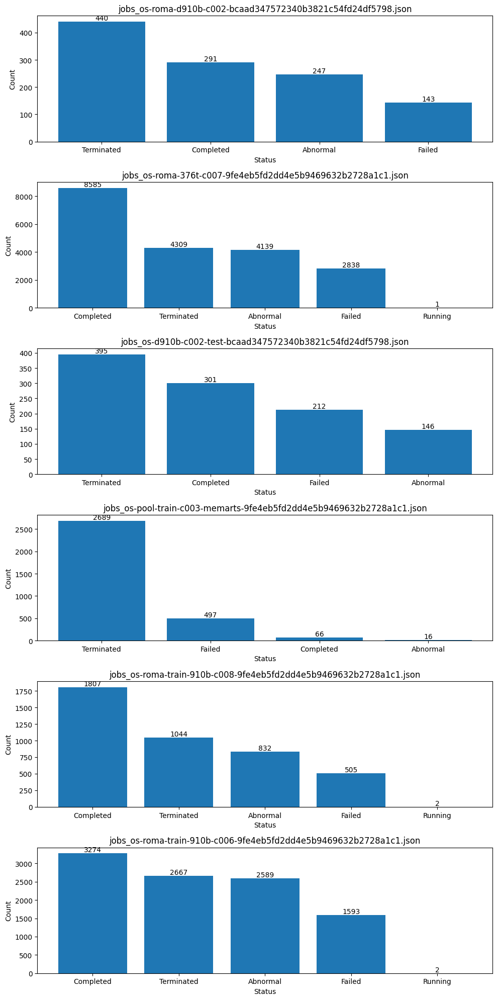

In [14]:
    
titles = [os.path.basename(title) for title in titles]
fig, axs = plt.subplots(len(dataframes),figsize=(10,20))

for i,dft in enumerate(dataframes):
    status_counts = dft['status.phase'].value_counts()
    bars = axs[i].bar(status_counts.index,status_counts.values)
    axs[i].set_title(titles[i])
    axs[i].set_xlabel('Status')
    axs[i].set_ylabel('Count')

    for bar in bars:
        yval = bar.get_height()
        axs[i].text(bar.get_x()+ bar.get_width()/2, yval +0.05, yval, ha= 'center', va='bottom')
plt.tight_layout()
plt.show()

In [18]:
df1.shape[0]

1121

In [23]:
for i,dft in enumerate(dataframes):
    
    print("pool: "+titles[i]+", number of jobs: "+str(dft.shape[0]))

pool: jobs_os-roma-d910b-c002-bcaad347572340b3821c54fd24df5798.json, number of jobs: 1121
pool: jobs_os-roma-376t-c007-9fe4eb5fd2dd4e5b9469632b2728a1c1.json, number of jobs: 19872
pool: jobs_os-d910b-c002-test-bcaad347572340b3821c54fd24df5798.json, number of jobs: 1054
pool: jobs_os-pool-train-c003-memarts-9fe4eb5fd2dd4e5b9469632b2728a1c1.json, number of jobs: 3268
pool: jobs_os-roma-train-910b-c008-9fe4eb5fd2dd4e5b9469632b2728a1c1.json, number of jobs: 4190
pool: jobs_os-roma-train-910b-c006-9fe4eb5fd2dd4e5b9469632b2728a1c1.json, number of jobs: 10125


In [15]:
df_concat= pd.concat(dataframes,ignore_index=True)

In [16]:
df_concat.describe()

,metadata.create_time,status.duration,status.retry_count,status.start_time,status.metrics_statistics.cpu_usage.average,status.metrics_statistics.cpu_usage.max,status.metrics_statistics.cpu_usage.min,status.metrics_statistics.mem_usage.average,status.metrics_statistics.mem_usage.max,status.metrics_statistics.mem_usage.min,...,status.metrics_statistics.npu.util.max,status.metrics_statistics.npu.util.min,spec.resource.node_count,spec.resource.pool_info.core_num,spec.resource.pool_info.mem_size,spec.resource.pool_info.cache_size,spec.resource.pool_info.accelerator_num,spec.schedule_policy.priority,scheduling_time,spec.auto_stop.duration
count,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,...,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,39630.00,39620.00,36988.00,32.00
mean,1708283468078.98,50174700.53,0.05,1594413271416.12,4.49,18.36,0.00,10.80,19.69,-0.08,...,27.88,-0.09,13.84,176.19,1473.64,181.50,7.75,2.38,965948.04,2.00
std,2530481897.81,252619719.77,9.15,426137266450.70,7.14,17.02,0.52,14.70,22.31,0.66,...,45.66,0.65,40.19,29.30,244.01,605.43,1.28,0.70,12496640.15,0.00
min,1704075622068.00,0.00,0.00,0.00,-1.00,-1.00,-1.00,-1.00,-1.00,-1.00,...,-1.00,-1.00,1.00,22.00,190.00,0.00,1.00,1.00,4337.00,2.00
25%,1705996969860.00,894000.00,0.00,1705630568500.00,0.78,4.79,0.00,0.14,0.79,0.00,...,0.00,0.00,1.00,182.00,1522.00,0.00,8.00,2.00,75805.00,2.00
50%,1708392518596.50,2789000.00,0.00,1707911416000.00,3.09,16.37,0.03,6.05,14.24,0.00,...,0.00,0.00,2.00,182.00,1522.00,0.00,8.00,3.00,112708.50,2.00
75%,1710520431928.00,9221750.00,0.00,1710422300750.00,5.59,25.73,0.10,15.22,28.56,0.01,...,49.00,0.00,16.00,182.00,1522.00,0.00,8.00,3.00,277724.25,2.00
max,1712785501768.00,10628453000.00,1820.00,1712840387000.00,91.88,100.00,25.80,97.85,100.00,67.66,...,239.00,90.00,606.00,182.00,1522.00,2201.00,8.00,3.00,1289472431.00,2.00


/tmp/ipykernel_123463/1353309082.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['group']).size()


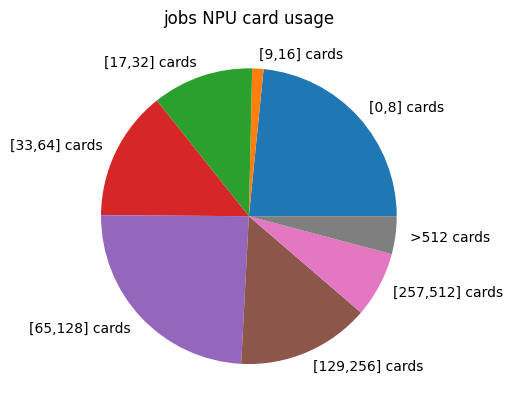

In [27]:
intervals = [8,16,24,32,64,128,256,512,float('inf')]
labels = ['[0,8] cards','[9,16] cards','[17,32] cards','[33,64] cards', '[65,128] cards', '[129,256] cards', '[257,512] cards', '>512 cards']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
df_sorted["group"] = pd.cut(df_sorted["spec.resource.node_count"],bins=intervals,labels=labels)
# job_counts = df_sorted["status.duration"].value_counts().sort_index()
grouped_df = df_sorted.groupby(['group']).size()

# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
# x= job_counts.index.astype(str)
# y= grouped_df.sum(axis=1)

grouped_df.plot(kind='pie')
plt.title('jobs NPU card usage')
# plt.xlabel('Running Duration')
# plt.ylabel('Job numbers')
# plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
# for i,v in enumerate(y):
#     plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_123463/2000451150.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  job_scale['numbers'][7] += 1
/tmp/ipykernel_123463/2000451150.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  job_scale['numbers'][7] += 1
/tmp/ipykernel_123463/2000451150.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  job_scale['numbers'][7] += 1
/tmp/ipykernel_123463/2000451150.py:22: SettingWithCopyWarning: 
A value is trying to be set o

NameError: name 'date' is not defined

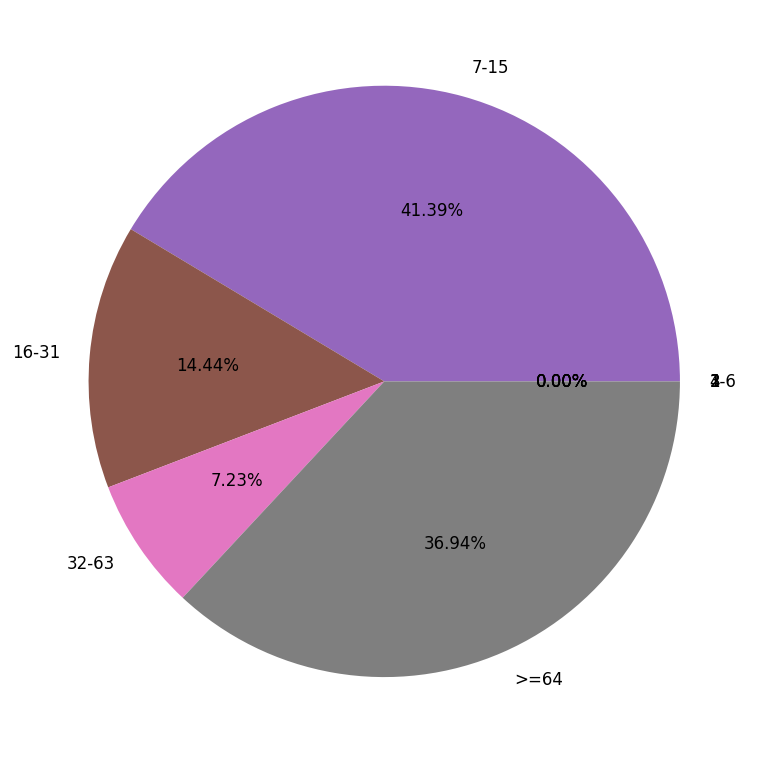

In [24]:
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

job = pd.concat(dataframes,ignore_index=True)

job['spec.resource.node_count'] = job['spec.resource.node_count']*8
job_scale = pd.DataFrame({'jobs':['1','2','3','4-6','7-15','16-31','32-63','>=64'],'numbers':[0,0,0,0,0,0,0,0]}, columns=['jobs','numbers'])
for num in job['spec.resource.node_count']:
    if num <4:
        job_scale['numbers'][num-1] += 1
    elif num < 7:
        job_scale['numbers'][3] += 1
    elif num < 16:
        job_scale['numbers'][4] += 1
    elif num < 32:
        job_scale['numbers'][5] += 1
    elif num < 64:
        job_scale['numbers'][6] += 1
    else:
        job_scale['numbers'][7] += 1

job_scale_weight = pd.DataFrame({'jobs':['8','16','32','<','7-15','16-31','32-63','>=64'],'numbers':[0,0,0,0,0,0,0,0]}, columns=['jobs','numbers'])
for num in job['spec.resource.node_count']:
    if num <4:
        job_scale_weight['numbers'][num-1] += num
    elif num < 7:
        job_scale_weight['numbers'][3] += num
    elif num < 16:
        job_scale_weight['numbers'][4] += num
    elif num < 32:
        job_scale_weight['numbers'][5] += num
    elif num < 64:
        job_scale_weight['numbers'][6] += num
    else:
        job_scale_weight['numbers'][7] += num

sizes = job_scale['numbers']
labels = job_scale['jobs']
plt.figure(figsize=(8,8),dpi=120)
plt.pie(sizes,         # 每个扇区大小
        labels=labels, # 每个扇区标签
        autopct='%.2f%%', # 计算百分比格式 %格式%   %d%% 整数百分比  %.2f%% 小数点后保留2位的浮点数百分比
        )

plt.title("NPU card used in jobs ")

In [117]:
df1 = df1.dropna(subset=['scheduling_time'])
df2 = df1.dropna(subset=['scheduling_time'])
df3 = df1.dropna(subset=['scheduling_time'])
df4 = df1.dropna(subset=['scheduling_time'])
df5 = df1.dropna(subset=['scheduling_time'])
df6 = df1.dropna(subset=['scheduling_time'])


/tmp/ipykernel_90418/2303320526.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(axs[i].get_xticklabels(), rotation=45,ha="right",rotation_mode = "anchor")
/tmp/ipykernel_90418/2303320526.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(axs[i].get_xticklabels(), rotation=45,ha="right",rotation_mode = "anchor")
/tmp/ipykernel_90418/2303320526.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(axs[i].get_xticklabels(), rotation=45,ha="right",rotation_mode = "anchor")
/tmp/ipykernel_90418/2303320526.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(axs[i].

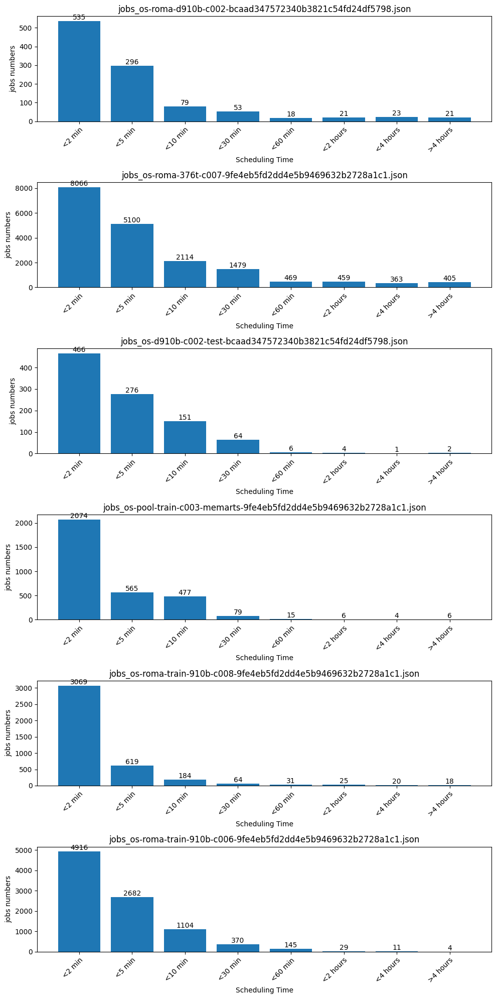

In [118]:
titles = [os.path.basename(title) for title in titles]
fig, axs = plt.subplots(len(dataframes),figsize=(10,20))
intervals = [0,120,300,600,1800,3600,7200,14400,float('inf')]
labels = ['<2 min','<5 min','<10 min','<30 min','<60 min','<2 hours', '<4 hours','>4 hours']
for i,dft in enumerate(dataframes):
    dfb = dft.dropna(subset=['scheduling_time'])
    df_sorted = dfb.sort_values("scheduling_time")
    df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
    df_sorted["scheduling_time"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
    job_counts = df_sorted["scheduling_time"].value_counts().sort_index()
    x= job_counts.index.astype(str)
    y= job_counts.values
    
    
    bars = axs[i].bar(x,y)
    axs[i].set_title(titles[i])
    axs[i].set_xlabel('Scheduling Time')
    axs[i].set_ylabel('jobs numbers')
    axs[i].set_xticklabels(axs[i].get_xticklabels(), rotation=45,ha="right",rotation_mode = "anchor")
    for bar in bars:
        yval = bar.get_height()
        axs[i].text(bar.get_x()+ bar.get_width()/2, yval +0.05, yval, ha= 'center', va='bottom')
plt.tight_layout()
plt.show()

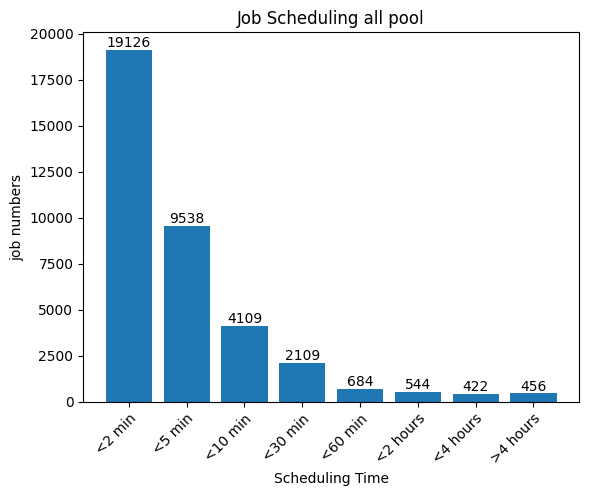

In [119]:
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,120,300,600,1800,3600,7200,14400,float('inf')]
labels = ['<2 min','<5 min','<10 min','<30 min','<60 min','<2 hours', '<4 hours','>4 hours']
dfb = df_concat.dropna(subset=['scheduling_time'])
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted["scheduling_time"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
job_counts = df_sorted["scheduling_time"].value_counts().sort_index()
x= job_counts.index.astype(str)
y= job_counts.values


plt.bar(x,y)
plt.title('Job Scheduling all pool')
plt.xlabel('Scheduling Time')
plt.ylabel('job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

In [120]:
df['status.duration']

0        312235000
1          2664000
2            59000
3            58000
4         42041000
           ...    
10117      2592000
10118         1000
10119         1000
10122     20768000
10123     21227000
Name: status.duration, Length: 9261, dtype: int64

In [121]:
df_concat.groupby('scheduling_time')['spec.resource.pool_info.accelerator_num'].sum()

scheduling_time
4337.00          8
5464.00          8
5469.00          8
5631.00          8
5871.00          8
                ..
261985419.00     8
298051317.00     8
1160003462.00    8
1257399516.00    1
1289472431.00    1
Name: spec.resource.pool_info.accelerator_num, Length: 34133, dtype: int64

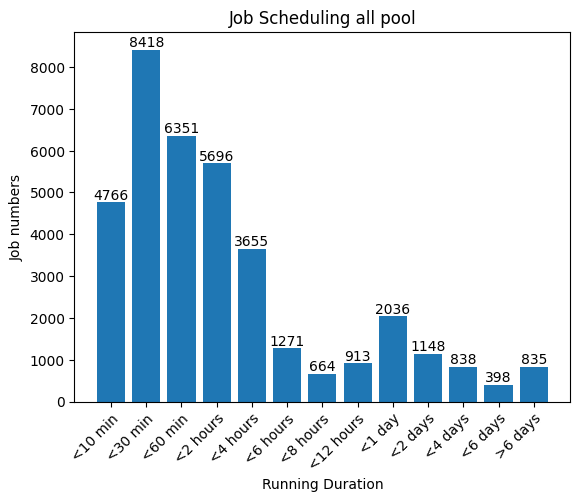

In [122]:
###cards###
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
job_counts = df_sorted["status.duration"].value_counts().sort_index()
x= job_counts.index.astype(str)
y= job_counts.values


plt.bar(x,y)
plt.title('Job Scheduling all pool')
plt.xlabel('Running Duration')
plt.ylabel('Job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

In [123]:
df_concat['status.duration'].sort_values()

38537              0
18893              0
18896              0
18523              0
1882               0
            ...     
34772     4584644000
34774     4587517000
34812     4652305000
21340     6238731000
39039    10628453000
Name: status.duration, Length: 39630, dtype: int64

/tmp/ipykernel_90418/2021608770.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  npu_counts = df_sorted.groupby('status.duration')['spec.resource.node_count'].sum()


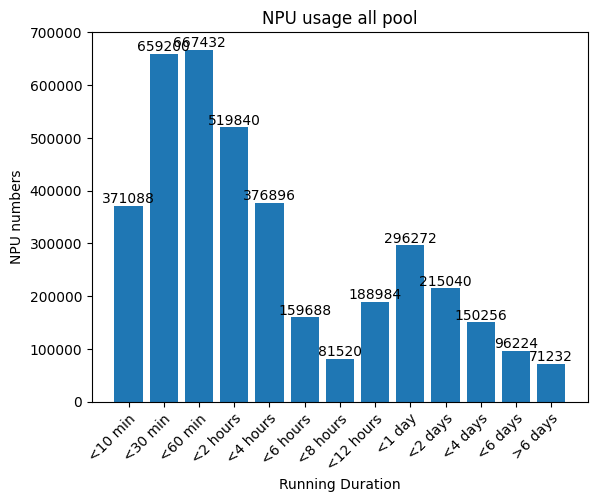

In [127]:
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
npu_counts = df_sorted.groupby('status.duration')['spec.resource.node_count'].sum()
x= npu_counts.index.astype(str)
y= npu_counts.values


plt.bar(x,y)
plt.title('NPU usage all pool')
plt.xlabel('Running Duration')
plt.ylabel('NPU numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

/tmp/ipykernel_90418/4155640472.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '<10 min'),
  Text(1, 0, '<30 min'),
  Text(2, 0, '<60 min'),
  Text(3, 0, '<2 hours'),
  Text(4, 0, '<4 hours'),
  Text(5, 0, '<6 hours'),
  Text(6, 0, '<8 hours'),
  Text(7, 0, '<12 hours'),
  Text(8, 0, '<1 day'),
  Text(9, 0, '<2 days'),
  Text(10, 0, '<4 days'),
  Text(11, 0, '<6 days'),
  Text(12, 0, '>6 days')])

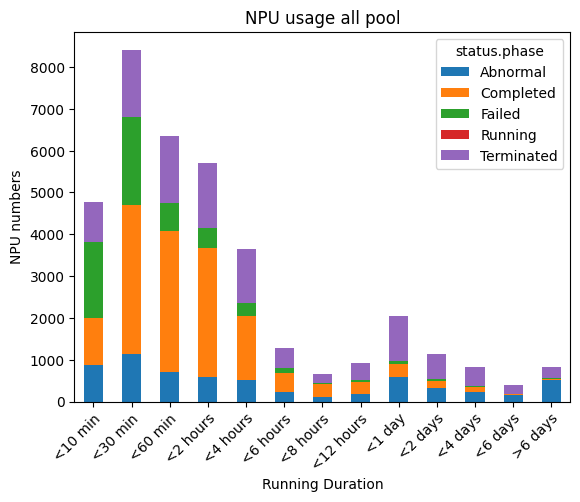

In [128]:
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration.group"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
# npu_counts = df_sorted.groupby('status.duration')['spec.resource.node_count'].sum()
grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()
x= npu_counts.index.astype(str)
y= npu_counts.values


grouped_df.plot(kind='bar',stacked=True)
plt.title('NPU usage all pool')
plt.xlabel('Running Duration')
plt.ylabel('NPU numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
# for i,v in enumerate(y):
#     plt.text(i,v,str(v),ha='center',va='bottom')

/tmp/ipykernel_90418/3482191090.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()


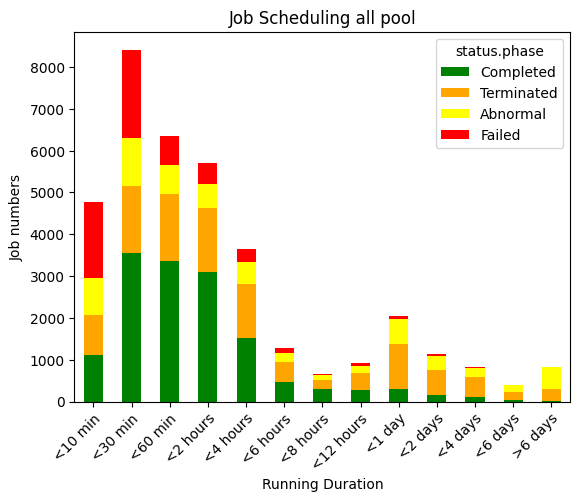

In [130]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration.group"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
# job_counts = df_sorted["status.duration"].value_counts().sort_index()

grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()
# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
# x= job_counts.index.astype(str)
# y= job_counts.values

grouped_df = grouped_df[['Completed','Terminated','Abnormal','Failed']]
grouped_df.plot(kind='bar',stacked=True, color=colors)
plt.title('Job Scheduling all pool')
plt.xlabel('Running Duration')
plt.ylabel('Job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
# for i,v in enumerate(y):
#     plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_90418/501412213.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_sorted["scheduling_time.group"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
/tmp/ipykernel_90418/501412213.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['scheduling_time.group','status.phase']).size().unstack()


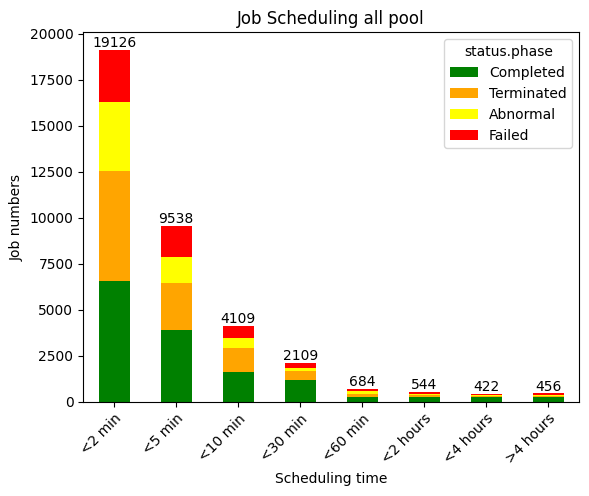

In [132]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,120,300,600,1800,3600,7200,14400,float('inf')]
labels = ['<2 min','<5 min','<10 min','<30 min','<60 min','<2 hours', '<4 hours','>4 hours']
dfb = df_concat.dropna(subset=['scheduling_time'])
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted["scheduling_time.group"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
job_counts = df_sorted["scheduling_time.group"].value_counts().sort_index()

grouped_df = df_sorted.groupby(['scheduling_time.group','status.phase']).size().unstack()
# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
x= job_counts.index.astype(str)
y= job_counts.values

grouped_df = grouped_df[['Completed','Terminated','Abnormal','Failed']]
grouped_df.plot(kind='bar',stacked=True, color=colors)
plt.title('Job Scheduling all pool')
plt.xlabel('Waiting time')
plt.ylabel('Job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_90418/4117518164.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  npu_counts = df_sorted.groupby(['scheduling_time','status.phase'])['spec.resource.node_count'].sum().unstack()


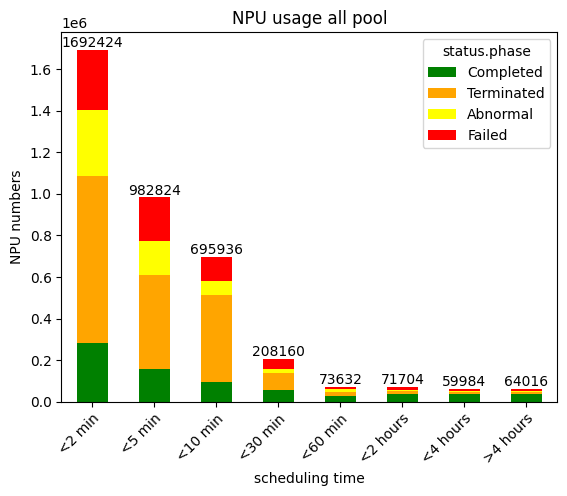

In [133]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,120,300,600,1800,3600,7200,14400,float('inf')]
labels = ['<2 min','<5 min','<10 min','<30 min','<60 min','<2 hours', '<4 hours','>4 hours']
dfb = df_concat.dropna(subset=['scheduling_time'])
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted["scheduling_time"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
npu_counts = df_sorted.groupby(['scheduling_time','status.phase'])['spec.resource.node_count'].sum().unstack()
y=npu_counts.sum(axis=1)
npu_counts = npu_counts[['Completed','Terminated','Abnormal','Failed']]
npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('NPU usage all pool')
plt.xlabel('Waiting time')
plt.ylabel('NPU numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

/tmp/ipykernel_99662/15839272.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()


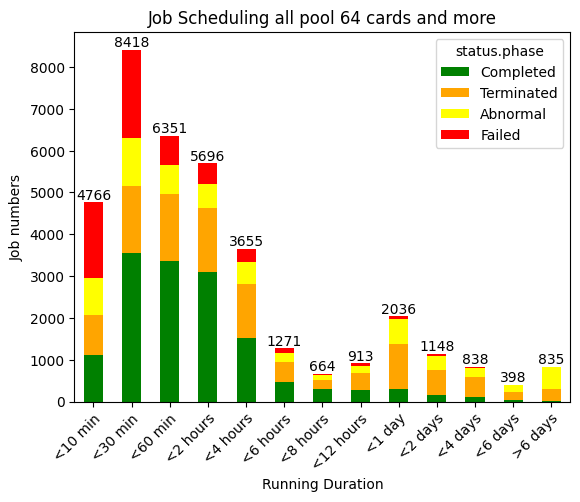

In [8]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration.group"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
# job_counts = df_sorted["status.duration"].value_counts().sort_index()

grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()
# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
# x= job_counts.index.astype(str)
y= grouped_df.sum(axis=1)

grouped_df = grouped_df[['Completed','Terminated','Abnormal','Failed']]
grouped_df.plot(kind='bar',stacked=True, color=colors)
plt.title('Job Scheduling  cards and more')
plt.xlabel('Running Duration')
plt.ylabel('Job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_90418/826017590.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  npu_counts = df_sorted.groupby(['status.duration','status.phase'])['spec.resource.node_count'].sum().unstack()


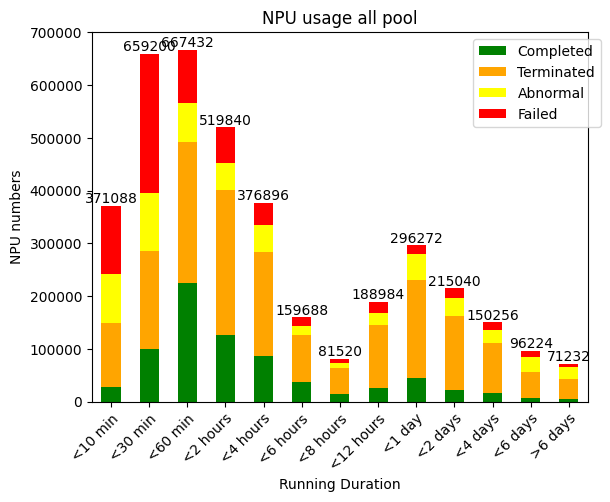

In [134]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
npu_counts = df_sorted.groupby(['status.duration','status.phase'])['spec.resource.node_count'].sum().unstack()
y=npu_counts.sum(axis=1)
npu_counts = npu_counts[['Completed','Terminated','Abnormal','Failed']]
npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('NPU usage all pool')
plt.xlabel('Running Duration')
plt.ylabel('NPU numbers')
plt.legend(bbox_to_anchor=(1.04,1),loc="upper right")
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

/tmp/ipykernel_114925/468123627.py:11: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_sorted["scheduling_time.group"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
/tmp/ipykernel_114925/468123627.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['scheduling_time.group','status.phase']).size().unstack()


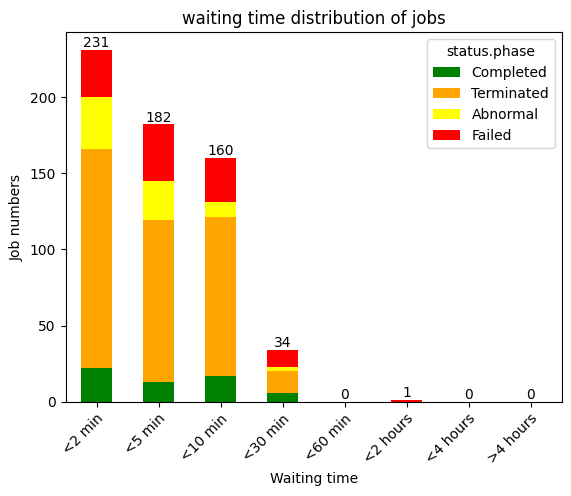

In [7]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,120,300,600,1800,3600,7200,14400,float('inf')]
labels = ['<2 min','<5 min','<10 min','<30 min','<60 min','<2 hours', '<4 hours','>4 hours']
dfb = df_concat.dropna(subset=['scheduling_time'])
dfb = dfb[dfb['spec.resource.node_count']*8 >= 1000]
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted["scheduling_time.group"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
job_counts = df_sorted["scheduling_time.group"].value_counts().sort_index()

grouped_df = df_sorted.groupby(['scheduling_time.group','status.phase']).size().unstack()
# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
x= job_counts.index.astype(str)
y= job_counts.values

grouped_df = grouped_df[['Completed','Terminated','Abnormal','Failed']]
grouped_df.plot(kind='bar',stacked=True, color=colors)
plt.title('waiting time distribution of jobs')
plt.xlabel('Waiting time')
plt.ylabel('Job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_114925/3468918974.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  npu_counts = df_sorted.groupby(['scheduling_time','status.phase'])['spec.resource.node_count'].sum().unstack()


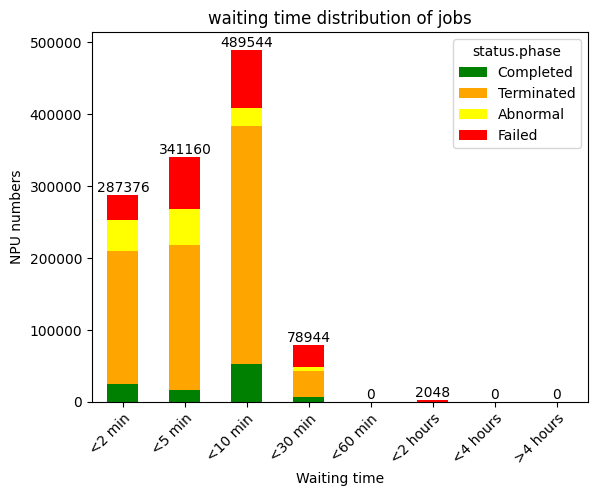

In [9]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,120,300,600,1800,3600,7200,14400,float('inf')]
labels = ['<2 min','<5 min','<10 min','<30 min','<60 min','<2 hours', '<4 hours','>4 hours']
dfb = df_concat.dropna(subset=['scheduling_time'])
dfb = dfb[dfb['spec.resource.node_count']*8 >= 1000]
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted["scheduling_time"] = pd.cut(df_sorted["scheduling_time"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
npu_counts = df_sorted.groupby(['scheduling_time','status.phase'])['spec.resource.node_count'].sum().unstack()
y=npu_counts.sum(axis=1)
npu_counts = npu_counts[['Completed','Terminated','Abnormal','Failed']]
npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('waiting time distribution of jobs')
plt.xlabel('Waiting time')
plt.ylabel('NPU numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

/tmp/ipykernel_114925/3079746039.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()


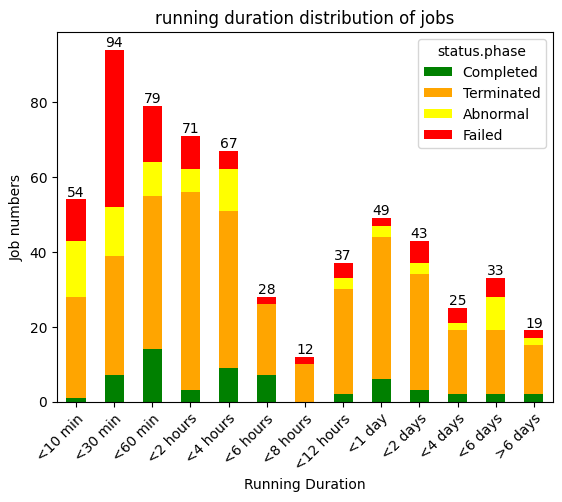

In [10]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
dfb = dfb[dfb['spec.resource.node_count']*8 >= 1000]
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration.group"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
# job_counts = df_sorted["status.duration"].value_counts().sort_index()

grouped_df = df_sorted.groupby(['status.duration.group','status.phase']).size().unstack()
# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
# x= job_counts.index.astype(str)
y= grouped_df.sum(axis=1)

grouped_df = grouped_df[['Completed','Terminated','Abnormal','Failed']]
grouped_df.plot(kind='bar',stacked=True, color=colors)
plt.title('running duration distribution of jobs')
plt.xlabel('Running Duration')
plt.ylabel('Job numbers')
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_114925/3511989294.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  npu_counts = df_sorted.groupby(['status.duration','status.phase'])['spec.resource.node_count'].sum().unstack()


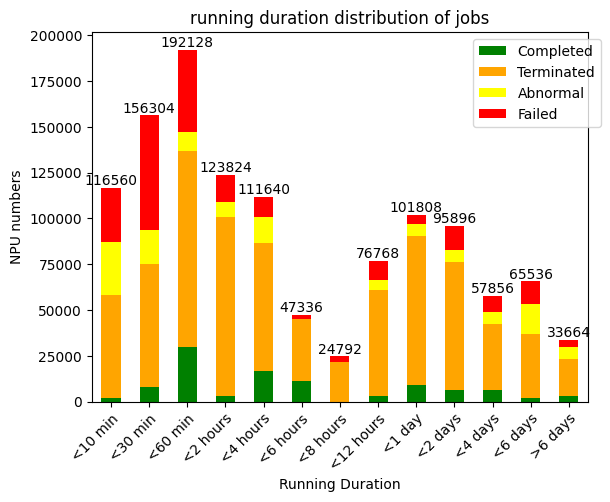

In [11]:
colors= ['green','orange','yellow','red']
category_order = ['Completed','Terminated','Abnormal','Failed']
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
dfb = dfb[dfb['spec.resource.node_count']*8 >= 1000]
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
npu_counts = df_sorted.groupby(['status.duration','status.phase'])['spec.resource.node_count'].sum().unstack()
y=npu_counts.sum(axis=1)
npu_counts = npu_counts[['Completed','Terminated','Abnormal','Failed']]
npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('running duration distribution of jobs')
plt.xlabel('Running Duration')
plt.ylabel('NPU numbers')
plt.legend(bbox_to_anchor=(1.04,1),loc="upper right")
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
for i,v in enumerate(y):
    plt.text(i,v,str(v),ha='center',va='bottom')

In [17]:
grouped_df = df_sorted.groupby(['status.duration.group']).size()
grouped_df

/tmp/ipykernel_114925/3761560260.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['status.duration.group']).size()


status.duration.group
<10 min      54
<30 min      94
<60 min      79
<2 hours     71
<4 hours     67
<6 hours     28
<8 hours     12
<12 hours    37
<1 day       49
<2 days      43
<4 days      25
<6 days      33
>6 days      19
dtype: int64

/tmp/ipykernel_114925/2879551327.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_df = df_sorted.groupby(['status.duration.group']).size()


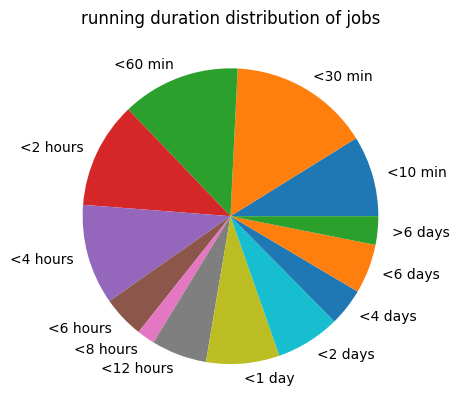

In [19]:
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
dfb = dfb[dfb['spec.resource.node_count']*8 >= 1000]
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration.group"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
# job_counts = df_sorted["status.duration"].value_counts().sort_index()
grouped_df = df_sorted.groupby(['status.duration.group']).size()

# grouped_df['status.phase'] = grouped_df['status.phase'].astype('category')
# grouped_df['status.phase'].cat.reorder_categories(category_order,inplace=True)
# x= job_counts.index.astype(str)
# y= grouped_df.sum(axis=1)

grouped_df.plot(kind='pie')
plt.title('running duration distribution of jobs')
# plt.xlabel('Running Duration')
# plt.ylabel('Job numbers')
# plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
# for i,v in enumerate(y):
#     plt.text(i,v,str(v),ha='center',va='bottom')

plt.show()

/tmp/ipykernel_114925/1173417440.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  npu_counts = df_sorted.groupby(['status.duration'])['spec.resource.node_count'].sum()


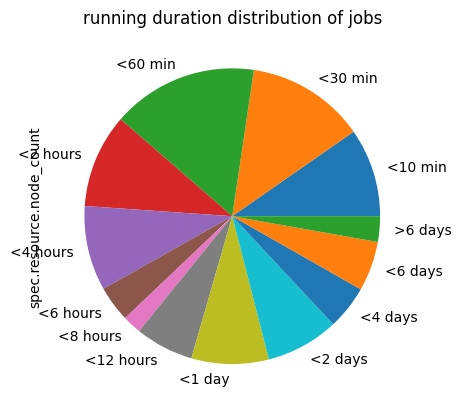

In [22]:
intervals = [0,600,1800,3600,7200,14400,21600,28800,43200,86400,172800,345600,518400,float('inf')]
labels = ['<10 min','<30 min','<60 min','<2 hours', '<4 hours', '<6 hours', '<8 hours', '<12 hours', '<1 day', '<2 days', '<4 days', '<6 days', '>6 days']
dfb = df_concat.dropna(subset=['status.duration'])
dfb = dfb[dfb['spec.resource.node_count']*8 >= 1000]
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
df_sorted["status.duration"] = pd.cut(df_sorted["status.duration"],bins=intervals,labels=labels)
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
npu_counts = df_sorted.groupby(['status.duration'])['spec.resource.node_count'].sum()
# y=npu_counts.sum(axis=1)
# npu_counts = npu_counts[['Completed','Terminated','Abnormal','Failed']]
npu_counts.plot(kind='pie')
plt.title('running duration distribution of jobs')
# plt.xlabel('Running Duration')
# plt.ylabel('NPU numbers')
# plt.legend(bbox_to_anchor=(1.04,1),loc="upper right")
# plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")
# for i,v in enumerate(y):
#     plt.text(i,v,str(v),ha='center',va='bottom')()
plt.show()

In [15]:
df_sorted

,kind,deleted_at,metadata.id,metadata.name,metadata.description,metadata.create_time,metadata.workspace_id,metadata.ai_project,metadata.labels.cluster.id,metadata.labels.cluster.project.id,...,algorithm.environments.S3_OUTPUT_EVAL_FILE,algorithm.environments.CKPT_NAME_SUFFIX,algorithm.environments.MA_TERMINATION_GRACE_PERIOD_SECONDS,algorithm.environments.PYTHONPATH,algorithm.environments.s3_lora_load_ckpt_path,algorithm.environments.LR_WRAMUP_ITERS,algorithm.engine.script_interpreter,endpoints.ssh.encrypted_token,algorithm.environments.OUTPUT_FOLDER,status.duration.group
30571,job,2024-03-31T11:06:24+08:00,99a3c7ac-4648-411a-ae78-179c36d26894,MM_mixture_doc_natImg_v1-0-1-copy-6605,"SFT 910B4 1024p V1-0-1-Doc, txtimgconcat, unfr...",1711727401635,0,default-ai-project,7212ee01-95a6-11ee-9941-0255ac100048,bcaad347572340b3821c54fd24df5798,...,None,None,None,None,None,None,None,None,None,NaN
21054,job,2024-03-09T21:45:13+08:00,b094cd2c-28cb-4bf8-a74c-b61d21c201e5,ICBC-Important-135B-pretrain-6094-copy-1660,135B 40heads from 71B 229200 step 284000 cons...,1709991878326,0,default-ai-project,None,None,...,None,None,None,None,None,None,None,None,None,NaN
21034,job,2024-04-11T09:38:21+08:00,1a4ce571-62cb-448b-a0e8-3f31897b8e68,pangu-sigma-230B-BF16-came-4096p-copy-6992,"pp均衡, 多副本, 选重, FA, from 127500step，head96, 4k数...",1711109041486,0,default-ai-project,None,None,...,None,None,None,None,None,None,None,None,None,NaN
21030,job,2024-03-26T14:01:10+08:00,9b37e435-7457-451d-ad28-a5b7ef847108,pangu-sigma-230B-BF16-came-4096p-copy-7831,"eod_reset，pp均衡, 多副本, 选重, FA, from 133500step，h...",1711429986876,0,default-ai-project,None,None,...,None,None,None,None,None,None,None,None,None,NaN
104,job,2024-04-01T16:39:19+08:00,de966236-141e-4f2a-8531-168a92f9710d,ICBC-Important-135-pretrain-6094-copy-4383,135B 40heads from 71B 229200 step 401200 cons...,1711902762287,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,None,None,None,None,None,None,None,None,None,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1118,job,None,0ee7237a-789b-45c3-bff4-802976663190,ICBC-Important-longSeq-sft-copy-5831,71B长序列V3 SFT pose256K stage2 载入ckpt238200 FA ...,1704159356272,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,>6 days
326,job,None,57294da7-6bda-476d-b6a0-e0966a7fed92,pangu-sigma-230B-BF16-came-2048p-copy-7047,"w92, FA, from 57000step，head96, 2k数据集, qkv-sca...",1708000727797,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,>6 days
27195,job,None,a8fc04ff-70f4-4219-a784-3443fc883d5e,as_test-240207-163228,Done formal_7b_0207,1707294790776,0,default-ai-project,be63e7be-aa0d-11ee-a141-0255ac10003a,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,>6 days
374,job,None,0c35e773-a199-438a-a339-db2e70d89f9a,pangu-sigma-230B-BF16-came-512p-copy-3937,"w213, FA, train from scratch，head96, 2k数据集, qk...",1705989202667,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,>6 days


In [12]:
df_concat= pd.concat(dataframes,ignore_index=True)
dfb = df_concat.dropna(subset=['scheduling_time'])
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
y=npu_counts.sum(axis=1)
groups= df_sorted.groupby('spec.resource.pool_id')
for name, group in groups:
    plt.scatter(group["spec.resource.node_count"],group["scheduling_time"],label='-'.join(name.split('-')[:-1]))
# plt.scatter(df_sorted["status.duration"],df_sorted["spec.resource.node_count"],c=df_sorted['spec.resource.pool_id'],cmap='cmo.deep')
# npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('Scheduling time vs Number of NPU Used')
plt.xlabel('NPU numbers')
plt.ylabel('Scheduling time (in seconds)')
plt.ticklabel_format(style='plain')
plt.legend(bbox_to_anchor=(1.04,1),loc="upper right")
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")

array(['os-roma-train-910b-c006-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-roma-376t-c007-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-roma-train-910b-c008-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-d910b-c002-test-bcaad347572340b3821c54fd24df5798',
       'os-pool-train-c003-memarts-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-roma-d910b-c002-bcaad347572340b3821c54fd24df5798'],
      dtype=object)

In [70]:
df_sorted['spec.resource.pool_id'].unique()

array(['os-roma-train-910b-c008-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-roma-376t-c007-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-roma-train-910b-c006-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-pool-train-c003-memarts-9fe4eb5fd2dd4e5b9469632b2728a1c1',
       'os-roma-d910b-c002-bcaad347572340b3821c54fd24df5798',
       'os-d910b-c002-test-bcaad347572340b3821c54fd24df5798'],
      dtype=object)

(array([-500.,    0.,  500., 1000., 1500., 2000., 2500., 3000., 3500.,
        4000., 4500.]),
 [Text(-500.0, 0, '−500'),
  Text(0.0, 0, '0'),
  Text(500.0, 0, '500'),
  Text(1000.0, 0, '1000'),
  Text(1500.0, 0, '1500'),
  Text(2000.0, 0, '2000'),
  Text(2500.0, 0, '2500'),
  Text(3000.0, 0, '3000'),
  Text(3500.0, 0, '3500'),
  Text(4000.0, 0, '4000'),
  Text(4500.0, 0, '4500')])

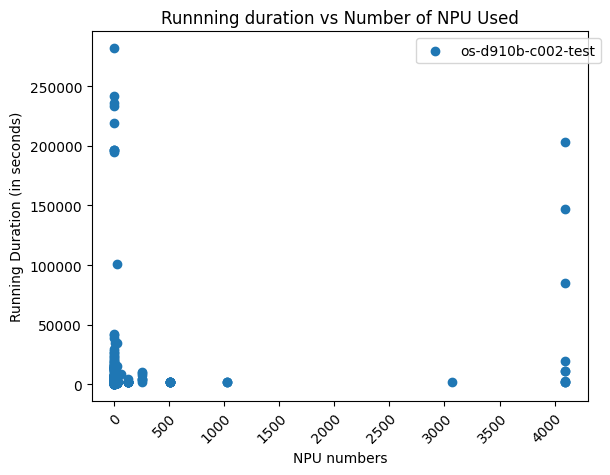

In [76]:
df_concat= pd.concat(dataframes,ignore_index=True)
dfb = df_concat.dropna(subset=['status.duration'])
df_sorted = dfb.sort_values("status.duration")
df_sorted["status.duration"] = df_sorted["status.duration"] /1000
# df_sorted = df_sorted[df_sorted['status.duration']<= 200000]
df_sorted = df_sorted[df_sorted['status.phase']== 'Completed']

df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
# df_sorted= df_sorted[df_sorted['spec.resource.node_count']>64]
df_sorted= df_sorted[df_sorted['spec.resource.pool_id']=='os-d910b-c002-test-bcaad347572340b3821c54fd24df5798']
groups= df_sorted.groupby('spec.resource.pool_id')
for name, group in groups:
    plt.scatter(group["spec.resource.node_count"],group["status.duration"],label='-'.join(name.split('-')[:-1]))
# plt.scatter(df_sorted["status.duration"],df_sorted["spec.resource.node_count"],c=df_sorted['spec.resource.pool_id'],cmap='cmo.deep')
# npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('Runnning duration vs Number of NPU Used')
plt.xlabel('NPU numbers')
plt.ylabel('Running Duration (in seconds)')
plt.ticklabel_format(style='plain')
plt.legend(bbox_to_anchor=(1.04,1),loc="upper right")
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")

In [63]:
df_sorted['status.duration']

3761        34000
3769        38000
25851       51000
3406        59000
3407        59000
           ...   
29617    19926000
25487    19930000
6670     19937000
6018     19955000
10086    19996000
Name: status.duration, Length: 13005, dtype: int64

In [53]:
df_concat.to_excel("Table20240101_20240411.xlsx")

In [14]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.io import output_notebook
from bokeh.models import ColumnDataSource
from bokeh.transform import factor_cmap
# import pandas_bokeh
# pandas_bokeh.output_notebook()
output_notebook()
from bokeh.models.widgets import DataTable,TableColumn
from bokeh.palettes import Spectral10
# data_table = DataTable(
#     columns=[TableColumn(field=Ci,title=Ci) for Ci in df_sorted.columns],
#     source= ColumnDataSource(df_sorted),
#     width=300,
#     height=300
# )

# p_scatter = df_sorted.plot_bokeh(
    
#     title = 'Runnning duration vs Number of NPU Used',
#     x='spec.resource.node_count',
#     y='status.duration',
#     category='spec.resource.pool_id',
       
# )
# pandas_bokeh.plot_grid([[data_table,p_scatter]],width=500,height=500)
source = ColumnDataSource(df_sorted)
pool = df_sorted['spec.resource.pool_id'].unique()
color_map = factor_cmap('spec.resource.pool_id', palette = Spectral10, factors= pool)
p = figure(title = 'Runnning duration vs Number of NPU Used',x_axis_label='Number of NPUs Used', y_axis_label='Job Running Duration')
p.scatter('spec.resource.node_count',"status.duration",source=source,fill_alpha=0.6,color=color_map, legend_field='spec.resource.pool_id', size=10)
p.legend.location= "top_right"
show(p)

Loading BokehJS ...

(array([-1000.,     0.,  1000.,  2000.,  3000.,  4000.,  5000.,  6000.]),
 [Text(-1000.0, 0, '−1000'),
  Text(0.0, 0, '0'),
  Text(1000.0, 0, '1000'),
  Text(2000.0, 0, '2000'),
  Text(3000.0, 0, '3000'),
  Text(4000.0, 0, '4000'),
  Text(5000.0, 0, '5000'),
  Text(6000.0, 0, '6000')])

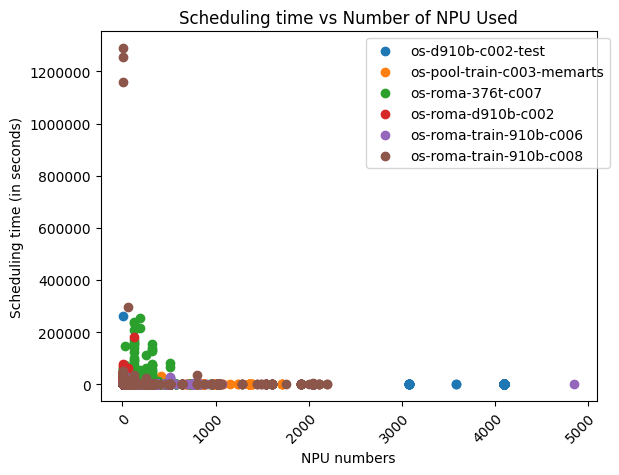

In [28]:
df_concat= pd.concat(dataframes,ignore_index=True)
dfb = df_concat.dropna(subset=['scheduling_time'])
df_sorted = dfb.sort_values("scheduling_time")
df_sorted["scheduling_time"] = df_sorted["scheduling_time"] /1000
df_sorted['spec.resource.node_count'] = df_sorted['spec.resource.node_count']*8
y=npu_counts.sum(axis=1)
groups= df_sorted.groupby('spec.resource.pool_id')
for name, group in groups:
    plt.scatter(group["spec.resource.node_count"],group["scheduling_time"],label='-'.join(name.split('-')[:-1]))
# plt.scatter(df_sorted["status.duration"],df_sorted["spec.resource.node_count"],c=df_sorted['spec.resource.pool_id'],cmap='cmo.deep')
# npu_counts.plot(kind='bar',stacked=True, color=colors)
plt.title('Scheduling time vs Number of NPU Used')
plt.xlabel('NPU numbers')
plt.ylabel('Scheduling time (in seconds)')
plt.ticklabel_format(style='plain')
plt.legend(bbox_to_anchor=(1.04,1),loc="upper right")
plt.xticks(rotation=45,ha="right",rotation_mode = "anchor")

In [25]:
df_sorted['status.duration']

38537          0.00
18893          0.00
18896          0.00
18523          0.00
1882           0.00
            ...    
34772    4584644.00
34774    4587517.00
34812    4652305.00
21340    6238731.00
39039   10628453.00
Name: status.duration, Length: 39630, dtype: float64

In [19]:
groups.status.duration

AttributeError: 'DataFrameGroupBy' object has no attribute 'status'

In [16]:
df['scheduling_time'] = df['status.start_time']-df['metadata.create_time']
df2['scheduling_time'] = df2['status.start_time']-df2['metadata.create_time']
df3['scheduling_time'] = df3['status.start_time']-df3['metadata.create_time']
df4['scheduling_time'] = df4['status.start_time']-df4['metadata.create_time']
df5['scheduling_time'] = df5['status.start_time']-df5['metadata.create_time']
df6['scheduling_time'] = df6['status.start_time']-df6['metadata.create_time']

In [17]:
df['scheduling_time']

0            105388
1            120573
2            172210
3             76422
4            239911
          ...      
76           138613
77   -1705890857126
78           124347
79           120806
80           102495
Name: scheduling_time, Length: 81, dtype: int64

In [6]:
dataframes = [df,df2,df3,df4,df5,df6]
df_concat= pd.concat(dataframes,ignore_index=True)
df_concat.describe(include="all")

,kind,deleted_at,metadata.id,metadata.name,metadata.description,metadata.create_time,metadata.workspace_id,metadata.ai_project,metadata.labels.cluster.id,metadata.labels.cluster.project.id,...,algorithm.environments.DST_CKPT_NUM,algorithm.environments.OBS_DST_STRATEGY_FILE,algorithm.environments.OBS_SRC_STRATEGY_FILE,metadata.annotations.train/toolkit,algorithm.engine.script_interpreter,spec.auto_stop.time_unit,spec.auto_stop.duration,spec.runtime_type,endpoints.ssh.key_pair_names,endpoints.ssh.encrypted_token
count,2247,290,2247,2247,2247,2.247000e+03,2247,2247,2180,2180,...,1,1,1,13,2,7,7.0,7,7,7
unique,1,260,2247,2225,1345,NaN,1,1,6,1,...,1,1,1,1,2,1,NaN,1,1,7
top,job,2024-01-23T09:45:16+08:00,08eb6e75-810b-4c1e-bb2e-213aa258653d,MGM_512Res_150M_16node_V0004,,NaN,0,default-ai-project,26490efe-68d3-11ee-b787-0255ac100035,bcaad347572340b3821c54fd24df5798,...,16,s3://bucket-pangu-green-guiyang/Pangu_RLHF/guq...,s3://bucket-pangu-green-guiyang/Pangu_RLHF/lid...,roma,os-roma-d910b-c006-siye,HOURS,NaN,debug,[SSH-WTS],AAAAAgAAAAAAAAAEAAAAAQAAAAfqqlRuGSIAZ+9U2INKIU...
freq,2247,4,1,2,265,NaN,2247,2247,887,2180,...,1,1,1,13,1,7,NaN,7,7,1
mean,NaN,NaN,NaN,NaN,NaN,1.706453e+12,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,7.798916e+08,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,1.705868e+12,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,1.705931e+12,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,1.706013e+12,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,1.706837e+12,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN


In [7]:
df_concat

,kind,deleted_at,metadata.id,metadata.name,metadata.description,metadata.create_time,metadata.workspace_id,metadata.ai_project,metadata.labels.cluster.id,metadata.labels.cluster.project.id,...,algorithm.environments.DST_CKPT_NUM,algorithm.environments.OBS_DST_STRATEGY_FILE,algorithm.environments.OBS_SRC_STRATEGY_FILE,metadata.annotations.train/toolkit,algorithm.engine.script_interpreter,spec.auto_stop.time_unit,spec.auto_stop.duration,spec.runtime_type,endpoints.ssh.key_pair_names,endpoints.ssh.encrypted_token
0,job,None,d457289c-bfd0-4f2d-83d5-c7e02a81d8b7,8ppangu-sigma-71B-150400-copy-0856,single_card_test,1708422260612,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,job,None,3066eb2e-4c07-44c4-8710-4f029813ae1e,8ppangu-sigma-71B-150400-copy-7501,single_card_test,1708411328427,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,job,None,d326aba6-94ef-40d5-8ea0-535e6f67807c,PEFT-910B-version-copy-6091,2p pbs1 new env 非batch gather,1708345422790,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,job,None,e9b71446-3b28-4799-99fe-3283787ec4dd,PEFT-910B-version-copy-7904,2p pbs1 new env batch gather,1708345162578,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,job,None,5deb3fbb-4b3a-41c2-9253-76fac50d3339,PEFT-910B-version-copy-4954,oom pbs8 new env 非batch gather,1708335876089,0,default-ai-project,565ff0d0-4003-11ee-9f10-0255ac100035,bcaad347572340b3821c54fd24df5798,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2242,job,None,14609a3c-9884-4607-ac10-adb817e3ab65,convert-ckpt-one-step-copy-5247,,1705886456758,0,default-ai-project,7212ee01-95a6-11ee-9941-0255ac100048,bcaad347572340b3821c54fd24df5798,...,None,None,None,None,None,None,NaN,None,None,None
2243,job,None,e1885712-a793-46dd-9eba-8d6967c2d7d9,71B-RM-inferece-mix-copy-6102,copy,1705886422669,0,default-ai-project,7212ee01-95a6-11ee-9941-0255ac100048,bcaad347572340b3821c54fd24df5798,...,None,None,None,None,None,None,NaN,None,None,None
2244,job,None,c46cc858-6312-43cc-8b1e-16627d42085f,71B-RM-inferece-mix-copy-1440,copy,1705886330476,0,default-ai-project,7212ee01-95a6-11ee-9941-0255ac100048,bcaad347572340b3821c54fd24df5798,...,None,None,None,None,None,None,NaN,None,None,None
2245,job,2024-01-22T10:10:55+08:00,db7e2497-c8f5-49c3-b570-d8496c603288,ckpt_135b_pp2_infer_test_0111-copy-2260,没卡死，在调试,1705885724472,0,default-ai-project,7212ee01-95a6-11ee-9941-0255ac100048,bcaad347572340b3821c54fd24df5798,...,None,None,None,None,None,None,NaN,None,None,None


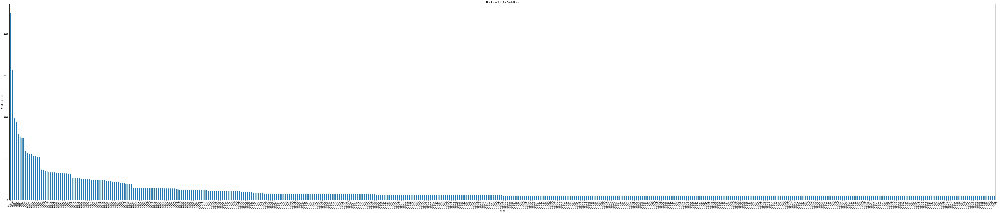

In [13]:
df_expanded = df_concat.explode('status.tasks')
node_c = df_expanded['status.tasks'].value_counts()
plt.figure(figsize=(100,20))
node_c.plot(kind='bar')

plt.xlabel('Node')
plt.ylabel('Number of Jobs')
plt.title('Number of Jobs for Earch Node')

plt.xticks(rotation=45)
plt.show()

In [14]:
df_concat.to_csv('dfpool4clusters.csv')

In [16]:
node_counts

status.tasks
worker-0      2247
worker-1      1559
worker-2       986
worker-3       939
worker-4       795
              ... 
worker-297      50
worker-296      50
worker-311      50
worker-310      50
worker-302      50
Name: count, Length: 512, dtype: int64

In [8]:
df_extract = df_concat[['metadata.id','metadata.name','metadata.create_time','metadata.labels.cluster.id','metadata.labels.cluster.id','metadata.user_name','status.phase','status.duration','status.node_count_metrics',
'status.tasks','algorithm.parameters','spec.resource.quota_id','spec.resource.node_count','spec.resource.pool_info.core_num','spec.resource.pool_info.mem_size','spec.schedule_policy.priority']]

In [9]:
flattened_data=pd.json_normalize(df_extract['algorithm.parameters'].explode().reset_index(drop=True))
flattened_data.columns = ['algorithm.parameters.' + str(col) for col in flattened_data.columns]
flattened_data = flattened_data[['algorithm.parameters.name','algorithm.parameters.value']]
df_extract = df_extract.join(flattened_data)

In [10]:
df_extract['metadata.name.substring'] = df_extract['metadata.name'].str.split('-').str[0:2].str.join('-')

In [11]:
df_extract[df_extract['metadata.name'].str.contains('pangu',case='False')]

,metadata.id,metadata.name,metadata.create_time,metadata.labels.cluster.id,metadata.labels.cluster.id,metadata.user_name,status.phase,status.duration,status.node_count_metrics,status.tasks,algorithm.parameters,spec.resource.quota_id,spec.resource.node_count,spec.resource.pool_info.core_num,spec.resource.pool_info.mem_size,spec.schedule_policy.priority,algorithm.parameters.name,algorithm.parameters.value,metadata.name.substring
0,d457289c-bfd0-4f2d-83d5-c7e02a81d8b7,8ppangu-sigma-71B-150400-copy-0856,1708422260612,565ff0d0-4003-11ee-9f10-0255ac100035,565ff0d0-4003-11ee-9f10-0255ac100035,csb-staff-23021430,Failed,1516000,None,[worker-0],"[{'name': 'ckpt_name_prefix', 'description': '...",pool-siye-376t-loss-debug-3,1,182,1522,2,ckpt_name_prefix,pangu-intelligent__,8ppangu-sigma
1,3066eb2e-4c07-44c4-8710-4f029813ae1e,8ppangu-sigma-71B-150400-copy-7501,1708411328427,565ff0d0-4003-11ee-9f10-0255ac100035,565ff0d0-4003-11ee-9f10-0255ac100035,csb-staff-23021430,Terminated,10741000,None,[worker-0],"[{'name': 'ckpt_name_prefix', 'description': '...",pool-siye-376t-loss-debug-3,1,182,1522,2,data_start_index,33,8ppangu-sigma
14,57294da7-6bda-476d-b6a0-e0966a7fed92,pangu-sigma-230B-BF16-came-2048p-copy-7047,1708000727797,565ff0d0-4003-11ee-9f10-0255ac100035,565ff0d0-4003-11ee-9f10-0255ac100035,csb-staff-23021430,Completed,970267000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'attention_type', 'description': '',...",os-roma-d910b-siye-6k-pool,256,182,1522,3,parallel_speed_up_json_path,/home/ma-user/modelarts/user-job-dir/pangu_sig...,pangu-sigma
15,07525fc5-a92d-4290-b6aa-9e91e215d165,pangu-sigma-230B-BF16-came-2048p-copy-7114,1707278341592,565ff0d0-4003-11ee-9f10-0255ac100035,565ff0d0-4003-11ee-9f10-0255ac100035,csb-staff-23021430,Failed,718533000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'attention_type', 'description': '',...",os-roma-d910b-siye-6k-pool,256,182,1522,3,param_init_type,fp32,pangu-sigma
16,3e1202ca-2d55-41c8-b970-f0cb7270c451,pangu-sigma-230B-BF16-came-pretrain-copy-7783,1707277793277,565ff0d0-4003-11ee-9f10-0255ac100035,565ff0d0-4003-11ee-9f10-0255ac100035,csb-staff-23021430,Terminated,129000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'attention_type', 'description': '',...",os-roma-d910b-siye-6k-pool,256,182,1522,3,per_batch_size,1,pangu-sigma
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2104,10161eba-9081-4119-9d7a-88b354881cbf,agent-pangu-llm-lora-test-copy-9843,1705935668882,7212ee01-95a6-11ee-9941-0255ac100048,7212ee01-95a6-11ee-9941-0255ac100048,csb-staff-23052411,Failed,882000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'LoRA', 'description': '', 'i18n_des...",os-roma-d910b-c006-siye,8,182,1522,3,offline,0,agent-pangu
2106,4bd7a410-4145-41ee-b9a7-4c3675f03183,agent-pangu-llm-lora-test-copy-3259,1705934915157,7212ee01-95a6-11ee-9941-0255ac100048,7212ee01-95a6-11ee-9941-0255ac100048,csb-staff-23052411,Failed,428000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'LoRA', 'description': '', 'i18n_des...",os-roma-d910b-c006-siye,8,182,1522,3,optimizer,came,agent-pangu
2116,d56a46c5-e827-4d05-b8d8-0bd2ba6b120f,agent-pangu-llm-test-copyy,1705931828943,7212ee01-95a6-11ee-9941-0255ac100048,7212ee01-95a6-11ee-9941-0255ac100048,csb-staff-23052411,Completed,19425000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'capacity_factor', 'description': ''...",os-roma-d910b-c006-siye,16,182,1522,3,save_checkpoint_steps,500,agent-pangu
2131,83b48af3-08d1-4c93-b8e0-c3ce1a50225e,agent-pangu-llm-test-copy-8880,1705929091302,7212ee01-95a6-11ee-9941-0255ac100048,7212ee01-95a6-11ee-9941-0255ac100048,csb-staff-23052411,Completed,7873000,None,"[worker-0, worker-1, worker-2, worker-3, worke...","[{'name': 'capacity_factor', 'description': ''...",os-roma-d910b-c006-siye,32,182,1522,3,data_start_index,0,agent-pangu


In [12]:
titles = glob.glob('workloads_of_large_pools_in_cn_southwest_2/workloads_of_large_pools_in_cn_southwest_2/*')
dfp = []
for title in titles:
    with open(title,'r') as f:
        json_data = json.load(f)
        dft = [pd.DataFrame(json_data)]
        dft = pd.DataFrame(json_data)
        dft.reset_index(inplace=True)
        dft = dft.drop('index',axis=1)
        dfp.append(dft)

In [14]:
df7,df8,df9,df10,df11,df12 = dfp
dataframes2 = [df7,df8,df9,df10,df11,df12]
df_concat2= pd.concat(dataframes2,ignore_index=True)

In [15]:
merged = df_concat.merge(df_concat2, left_on='metadata.id', right_on='uid')

In [1]:
df_concat2['uid']

SyntaxError: invalid syntax (3301647008.py, line 1)

In [16]:
df_concat['metadata.id'] 

0       d457289c-bfd0-4f2d-83d5-c7e02a81d8b7
1       3066eb2e-4c07-44c4-8710-4f029813ae1e
2       d326aba6-94ef-40d5-8ea0-535e6f67807c
3       e9b71446-3b28-4799-99fe-3283787ec4dd
4       5deb3fbb-4b3a-41c2-9253-76fac50d3339
                        ...                 
2242    14609a3c-9884-4607-ac10-adb817e3ab65
2243    e1885712-a793-46dd-9eba-8d6967c2d7d9
2244    c46cc858-6312-43cc-8b1e-16627d42085f
2245    db7e2497-c8f5-49c3-b570-d8496c603288
2246    08eb6e75-810b-4c1e-bb2e-213aa258653d
Name: metadata.id, Length: 2247, dtype: object

In [50]:
merged

,kind_x,deleted_at,metadata.id,metadata.name,metadata.description,metadata.create_time,metadata.workspace_id,metadata.ai_project,metadata.labels.cluster.id,metadata.labels.cluster.project.id,...,createTime,runningDuration,pendingPosition,gvk,isDeleted,hostIps,resourceRequirement.cpu,resourceRequirement.memory,resourceRequirement.huawei.com/ascend-1980,pendingDuration


In [32]:
flattened_data.describe(include='all')

,name,description,i18n_description,value,constraint.type,constraint.editable,constraint.required,constraint.sensitive,constraint.valid_type,constraint.valid_range
count,23545,23545,0.0,23545,23545,23545,23545,23545,23545,0.0
unique,310,1,NaN,979,1,1,1,1,1,NaN
top,input_url,,NaN,1,,False,False,False,,NaN
freq,900,23545,NaN,3252,23545,23545,23545,23545,23545,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
df_extract['metadata.name.substring'].str.contains('pangu',case='False').sum()

141

In [7]:
df2.columns.to_series().to_csv('columns4clusters.csv',index=False)

In [10]:
df.to_csv('columnsC002Test.csv',index=False)